In [57]:
# Imports Statements

import csv
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
import os
import pandas as pd

# Code for Heatmap and Data Contained Below

In [58]:
# Convert final.txt to heatmap.csv format

filename = 'Part29_Kaylee_Final_NG.txt'
file_vid = 'final_Sam_BL'
savedname = filename[0:-4] + '.png'

with open(filename, 'r') as in_file:
    stripped = (line.strip() for line in in_file)
    lines = (line.split(",") for line in stripped if line)
    with open('heatmap.csv', 'w') as out_file:
        writer = csv.writer(out_file)
        writer.writerows(lines)

In [59]:
# Convert floating point values in heatmap.csv to integer values using python round() functionality

new_rows = []

with open('heatmap.csv', 'r') as f:
    reader = csv.reader(f) 
    for row in reader: 
        new_row = row
        new_row[0] = round(float(row[0]))
        new_row[1] = round(float(row[1]))
        new_rows.append(new_row)
        
with open('heatmap.csv', 'w') as f:
    writer = csv.writer(f)
    writer.writerows(new_rows)

# Fine Grain Plot Movement Direction

In [60]:
if (filename[-6:-4] == 'NG' or filename[-6:-4] == 'GO'):
    final_mtx_outline = np.matrix([
                        [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 
                        [0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0],
                        [0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0],
                        [0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0],
                        [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0],
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0],
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0],
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0], 
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0], 
                        [0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], 
                        [0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0],  
                        [0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0],
                        [0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], 
                        [0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0],
                        [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0],
                        ])
elif (filename[-6:-4] == 'BL'):
    final_mtx_outline = np.matrix([
                        [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 
                        [0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0],
                        [0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0],
                        [0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0],
                        [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0],
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0],
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0],
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0], 
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0], 
                        [0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], 
                        [0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0],  
                        [0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0],
                        [0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], 
                        [0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0],
                        [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0],
                        ])

In [61]:
x_vals = []
y_vals = []
maze_x_vals = []
maze_y_vals = []
final_vals = []

def threshold_distance(lastval, currval):
    subtract = lastval - currval
    if (subtract <= -35 or subtract >= 35):
        return True
    return False
        
last_x_val = 0
last_y_val = 0
with open('heatmap.csv', 'r') as f:
    reader = csv.reader(f) 
    for row in reader:
        if (threshold_distance(int(row[0]),last_x_val) or threshold_distance(int(row[1]), last_y_val)):
            x_vals.append(int(row[0]))
            y_vals.append(int(row[1]))
            last_x_val = int(row[0])
            last_y_val = int(row[1])
        final_vals.append(row)
                    
# plt.scatter(x_vals, y_vals)
# plt.plot(x_vals, y_vals, '-')

# for r in range(15):
#     for c in range(15):
#         if (final_mtx_outline[r, c]) == 0:
#             maze_x_vals.append(99 * c)
#             maze_y_vals.append(99 * (14 - r + 1))


# plt.scatter(maze_x_vals, maze_y_vals)
# plt.plot(maze_x_vals, maze_y_vals, 'go')

# plt.title("Children Fine-Grain Maze Map")
# plt.xlabel("X Axis Points")
# plt.ylabel("Y Axis Points")

# ax = plt.gca()
# ax.set_facecolor('xkcd:salmon')
# ax.set_facecolor((1, 0.65, 0.42))

# plt.show()

In [62]:
new_mtx_sample = np.zeros((1485, 1485))

lastc = 0
lastr = 1386
for r in range(14, -1, -1):
    for c in range(15):
        if (final_mtx_outline[r, c]) == 1:
            new_mtx_sample[lastr: 99 * (r + 1), lastc: 99 * (c + 1)] = 1
        lastc += 99
    lastc = 0
    lastr -= 99
    
for l in final_vals:
    x_samp = int(l[0])
    y_samp = int(l[1])
    new_mtx_sample[1485 - y_samp - 8: 1485 - y_samp + 8, x_samp - 8: x_samp + 8] = 2

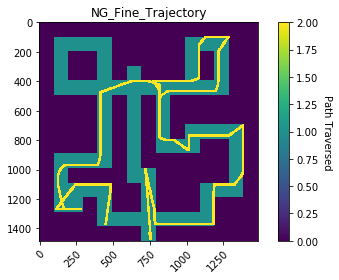

In [63]:
# Printing the Heatmap

harvest = new_mtx_sample

fig, ax = plt.subplots()
im = ax.imshow(harvest)

cbar = ax.figure.colorbar(im, ax=ax, cmap="YlGn")
cbar.ax.set_ylabel("Path Traversed", rotation=-90, va="bottom")

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
          rotation_mode="anchor")

ax.set_title(filename[-6:-4] + "_Fine_Trajectory")
fig.tight_layout()
#plt.savefig(filename[-6:-4] + '.png')
plt.show()

# Time Generation Interesting??

In [67]:
new_mtx_samp = np.zeros((1485, 1485))

lastc = 0
lastr = 1386
for r in range(14, -1, -1):
    for c in range(15):
        if (final_mtx_outline[r, c]) == 1:
            new_mtx_samp[lastr: 99 * (r + 1), lastc: 99 * (c + 1)] = 10000
        lastc += 99
    lastc = 0
    lastr -= 99
    
counter = 2
for l in final_vals:
    x_samp = int(l[0])
    y_samp = int(l[1])
    new_mtx_samp[1485 - y_samp - 8: 1485 - y_samp + 8, x_samp - 8: x_samp + 8] = counter
    counter += 1

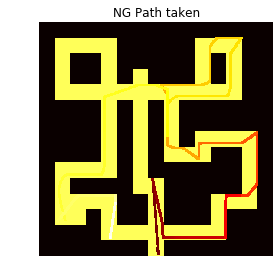

In [69]:
# Printing the Heatmap

harvest = new_mtx_samp

fig, ax = plt.subplots()
im = ax.imshow(harvest,cmap='hot')
#im = ax.imshow(harvest)

#YlOrRd or YlGn
#cbar = ax.figure.colorbar(im, ax=ax, cmap="PuBuGn")
#cbar.ax.set_ylabel("Time Visited", rotation=-90, va="bottom")

# Rotate the tick labels and set their alignment.
#plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
#          rotation_mode="anchor")

ax.set_title(filename[-6:-4] + " Path taken")
fig.tight_layout()
plt.axis('off')
#plt.savefig(filename[-6:-4] + '.png')
plt.show()

# Graph of Movement Direction

In [10]:
heatmap_data_dir = []
final_mtx_dir = np.zeros((15, 15))
final_mtx_revisit = np.zeros((15, 15))

with open('heatmap.csv', 'r') as f:
    reader = csv.reader(f) 
    for row in reader: 
        heatmap_data_dir.append(row)


count = 1
for l in heatmap_data_dir:
    for j in range(14, -1, -1):
        for i in range(15):
            if (int(l[0])//99 == i and int(l[1])//99 == j):
                if (final_mtx_dir[14 - j][i] != 0):
                    final_mtx_revisit[14 - j][i] = count * 2
                else:
                    final_mtx_dir[14 - j][i] = count
    count += 1

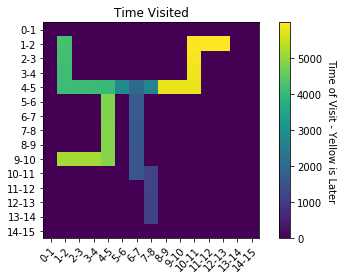

In [11]:
# Printing the Heatmap

vegetables = ["0-1", "1-2", "2-3", "3-4", "4-5", "5-6", "6-7", "7-8", "8-9", "9-10", "10-11", "11-12", "12-13", "13-14", "14-15"]
farmers = ["0-1", "1-2", "2-3", "3-4", "4-5", "5-6", "6-7", "7-8", "8-9", "9-10", "10-11", "11-12", "12-13", "13-14", "14-15"]

harvest = final_mtx_dir

fig, ax = plt.subplots()
im = ax.imshow(harvest)

cbar = ax.figure.colorbar(im, ax=ax, cmap="YlGn")
cbar.ax.set_ylabel("Time of Visit - Yellow is Later", rotation=-90, va="bottom")

ax.set_xticks(np.arange(len(farmers)))
ax.set_yticks(np.arange(len(vegetables)))
# ... and label them with the respective list entries
ax.set_xticklabels(farmers)
ax.set_yticklabels(vegetables)

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
          rotation_mode="anchor")

ax.set_title("Time Visited")
fig.tight_layout()
plt.show()

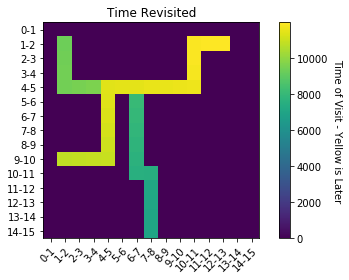

In [12]:
# Printing the Heatmap

vegetables = ["0-1", "1-2", "2-3", "3-4", "4-5", "5-6", "6-7", "7-8", "8-9", "9-10", "10-11", "11-12", "12-13", "13-14", "14-15"]
farmers = ["0-1", "1-2", "2-3", "3-4", "4-5", "5-6", "6-7", "7-8", "8-9", "9-10", "10-11", "11-12", "12-13", "13-14", "14-15"]

harvest = final_mtx_revisit

fig, ax = plt.subplots()
im = ax.imshow(harvest)

cbar = ax.figure.colorbar(im, ax=ax, cmap="YlGn")
cbar.ax.set_ylabel("Time of Visit - Yellow is Later", rotation=-90, va="bottom")

ax.set_xticks(np.arange(len(farmers)))
ax.set_yticks(np.arange(len(vegetables)))
# ... and label them with the respective list entries
ax.set_xticklabels(farmers)
ax.set_yticklabels(vegetables)

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
          rotation_mode="anchor")

ax.set_title("Time Revisited")
fig.tight_layout()
plt.show()

# Creating the Heatmap

In [11]:
# Note: X Ranges from 0 to 1385
# Note: Y Range from 0 to 1385
# Note: Maze is a 15 x 15 grid

heatmap_data = []
final_mtx = np.zeros((15, 15))

count_row = 0
with open('heatmap.csv', 'r') as f:
    reader = csv.reader(f) 
    for row in reader: 
        heatmap_data.append(row)
        count_row += 1

for l in heatmap_data:
    for j in range(14, -1, -1):
        for i in range(15):
            if (int(l[0])//99 == i and int(l[1])//99 == j):
                final_mtx[14 - j][i] += 1
                
#     if (int(l[0])//93 == 0 and int(l[1])//93 == 14):
#         final_mtx[0][0] += 1
#     elif (int(l[0])//93 == 1 and int(l[1])//93 == 14):
#         final_mtx[0][1] += 1
#     elif (int(l[0])//93 == 7 and int(l[1])//93 == 0):
#         final_mtx[14][7] += 1
#     elif (int(l[0])//93 == 8 and int(l[1])//93 == 0):
#         final_mtx[14][8] += 1
        
#print(final_mtx)


# To fine tune grid size - Change final_mtx_shape, and change iterating loops to ensure grid and heatmap correspondence - Ask Naren

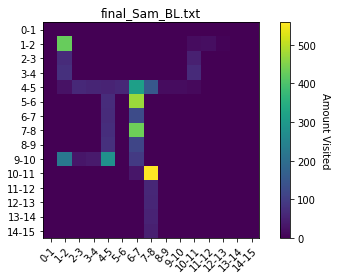

In [12]:
# Printing the Heatmap

vegetables = ["0-1", "1-2", "2-3", "3-4", "4-5", "5-6", "6-7", "7-8", "8-9", "9-10", "10-11", "11-12", "12-13", "13-14", "14-15"]
farmers = ["0-1", "1-2", "2-3", "3-4", "4-5", "5-6", "6-7", "7-8", "8-9", "9-10", "10-11", "11-12", "12-13", "13-14", "14-15"]

harvest = final_mtx
harvest[14][7] = 50

fig, ax = plt.subplots()
im = ax.imshow(harvest)

cbar = ax.figure.colorbar(im, ax=ax, cmap="YlGn")
cbar.ax.set_ylabel("Amount Visited", rotation=-90, va="bottom")

ax.set_xticks(np.arange(len(farmers)))
ax.set_yticks(np.arange(len(vegetables)))
# ... and label them with the respective list entries
ax.set_xticklabels(farmers)
ax.set_yticklabels(vegetables)

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
          rotation_mode="anchor")

ax.set_title(filename)
fig.tight_layout()
plt.savefig(savedname)
plt.show()

In [13]:
# Printing out the Data - Total Maze = 76 for other mazes
visit_count = 0
cell = [int(heatmap_data[0][0])//99, int(heatmap_data[0][1])//99]
for l in heatmap_data:
    temp_cell = [int(l[0])//99, int(l[1])//99]
    if temp_cell[0] != cell[0] or temp_cell[1] != cell[1]:
        visit_count += 1
        cell = temp_cell
        
if (filename[-6:-4] == 'NG'):
    total_maze_area = 80
elif (filename[-6:-4] == 'GO'):
    total_maze_area = 80
    if final_mtx[1][12] >= 1:
        print("Found Gummy in this trial!\n")
elif (filename[-6:-4] == 'BL'):
    total_maze_area = 79
    if final_mtx[1][12] >= 1:
        print("Found Gummy in this trial!\n")
area_covered = 0
area_repeated = 0
high_interest = 0

for x in range(0, final_mtx.shape[0]):
    for y in range(0, final_mtx.shape[1]):
        if (final_mtx[x][y] > 0):
            area_covered += 1
        if (final_mtx[x][y] > 100 and final_mtx[x][y] < 400):
            area_repeated += 1
        if (final_mtx[x][y] > 400):
            high_interest += 1
                
print("Percentage of Maze Explored: %8.2f" % (area_covered/total_maze_area * 100))
print("Percentage of Maze Re-Explored/High-Interest: %8.2f" % ((area_repeated + high_interest)/area_covered * 100))
print("Percentage of Maze Re-Explored relative to total: %8.2f" % ((area_repeated + high_interest)/total_maze_area * 100))
print("")
print("Number of Recordings Taken: %d" % count_row)
print("Number of Cells Visited: %d" % visit_count)

Found Gummy in this trial!

Percentage of Maze Explored:    46.84
Percentage of Maze Re-Explored/High-Interest:    27.03
Percentage of Maze Re-Explored relative to total:    12.66

Number of Recordings Taken: 5998
Number of Cells Visited: 84


# Code for Overlay Heatmap Image Generation Contained Below

In [14]:
if (filename[-6:-4] == 'NG' or filename[-6:-4] == 'GO'):
    final_mtx_outline = np.matrix([
                        [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 
                        [0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0],
                        [0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0],
                        [0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0],
                        [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0],
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0],
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0],
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0], 
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0], 
                        [0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], 
                        [0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0],  
                        [0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0],
                        [0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], 
                        [0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0],
                        [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0],
                        ])
elif (filename[-6:-4] == 'BL'):
    final_mtx_outline = np.matrix([
                        [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 
                        [0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0],
                        [0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0],
                        [0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0],
                        [0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0],
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0],
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0],
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0], 
                        [0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0], 
                        [0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0], 
                        [0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0],  
                        [0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0],
                        [0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0], 
                        [0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0],
                        [0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0],
                        ])

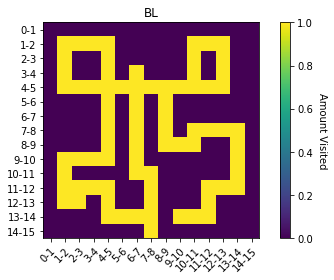

In [16]:
# Printing the Heatmap

vegetables = ["0-1", "1-2", "2-3", "3-4", "4-5", "5-6", "6-7", "7-8", "8-9", "9-10", "10-11", "11-12", "12-13", "13-14", "14-15"]
farmers = ["0-1", "1-2", "2-3", "3-4", "4-5", "5-6", "6-7", "7-8", "8-9", "9-10", "10-11", "11-12", "12-13", "13-14", "14-15"]

harvest = final_mtx_outline

fig, ax = plt.subplots()
im = ax.imshow(harvest)

cbar = ax.figure.colorbar(im, ax=ax, cmap="YlGn")
cbar.ax.set_ylabel("Amount Visited", rotation=-90, va="bottom")

ax.set_xticks(np.arange(len(farmers)))
ax.set_yticks(np.arange(len(vegetables)))
# ... and label them with the respective list entries
ax.set_xticklabels(farmers)
ax.set_yticklabels(vegetables)

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
          rotation_mode="anchor")

ax.set_title(filename[-6:-4])
fig.tight_layout()
#plt.savefig(filename[-6:-4] + '.png')
plt.show()

# Code for Video Frame Generation Below

## PNG --> Video: https://www.kapwing.com/resources/convert-a-png-to-an-mp4/

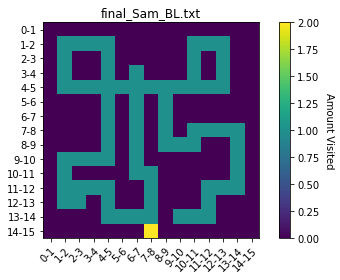

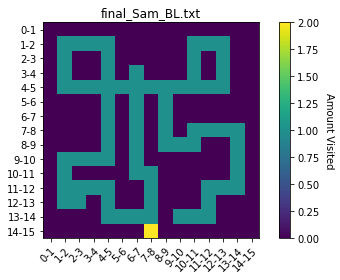

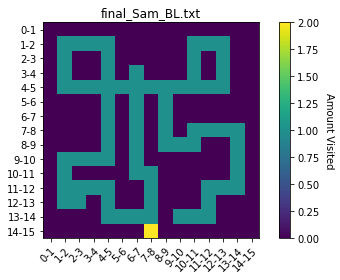

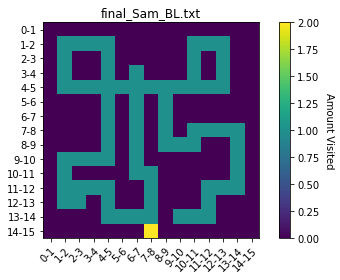

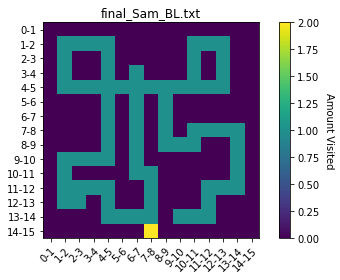

...

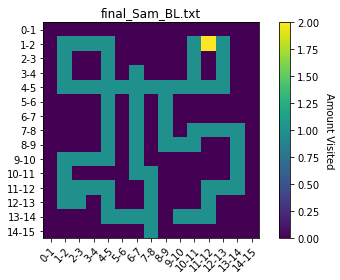

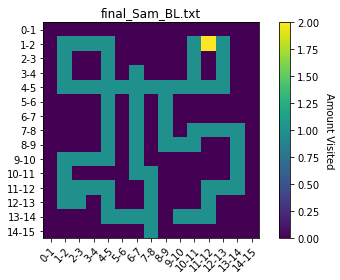

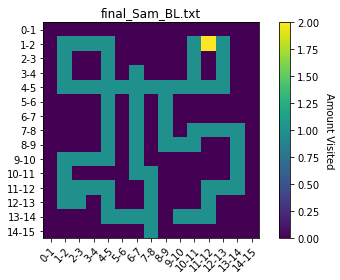

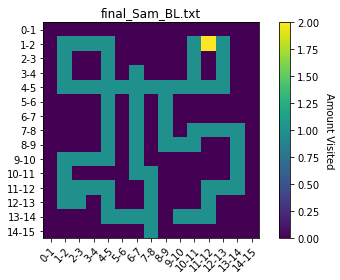

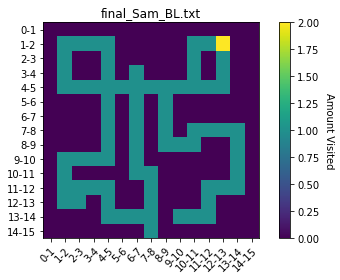

In [9]:
heatmap_data_video = []
final_mtx_video = final_mtx_outline.copy()

with open('heatmap.csv', 'r') as f:
    reader = csv.reader(f) 
    for row in reader: 
        heatmap_data_video.append(row)

count = 1
for l in heatmap_data_video:
    if (count % 5 == 0):
        i = int(l[0])//99
        j = int(l[1])//99
        final_mtx_video[14 - j, i] = 2

        vegetables = ["0-1", "1-2", "2-3", "3-4", "4-5", "5-6", "6-7", "7-8", "8-9", "9-10", "10-11", "11-12", "12-13", "13-14", "14-15"]
        farmers = ["0-1", "1-2", "2-3", "3-4", "4-5", "5-6", "6-7", "7-8", "8-9", "9-10", "10-11", "11-12", "12-13", "13-14", "14-15"]

        harvest = final_mtx_video

        fig, ax = plt.subplots()
        im = ax.imshow(harvest)

        cbar = ax.figure.colorbar(im, ax=ax, cmap="YlGn")
        cbar.ax.set_ylabel("Amount Visited", rotation=-90, va="bottom")

        ax.set_xticks(np.arange(len(farmers)))
        ax.set_yticks(np.arange(len(vegetables)))
        # ... and label them with the respective list entries
        ax.set_xticklabels(farmers)
        ax.set_yticklabels(vegetables)

        # Rotate the tick labels and set their alignment.
        plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
              rotation_mode="anchor")

        ax.set_title(filename)
        fig.tight_layout()
        plt.savefig('video_output/' + filename[0:-4] + '_' + str(count) + '.png')
        plt.show()
    count += 1
    final_mtx_video = final_mtx_outline.copy()

In [4]:
image_folder = 'video_output'
video_name = 'video_' + filename[0:-4] + '.avi'
images_sorted = []
count = 5


images = [img for img in os.listdir(image_folder) if img.endswith(".png")]
while len(images) != 0:
    for i in images:
        if (i == file_vid + '_' + str(count) + '.png'):
            images_sorted.append(i)
            images.remove(i)
    count += 5 

print(images_sorted)

['final_Sam_BL_5.png', 'final_Sam_BL_10.png', 'final_Sam_BL_15.png', 'final_Sam_BL_20.png', 'final_Sam_BL_25.png', 'final_Sam_BL_30.png', 'final_Sam_BL_35.png', 'final_Sam_BL_40.png', 'final_Sam_BL_45.png', 'final_Sam_BL_50.png', 'final_Sam_BL_55.png', 'final_Sam_BL_60.png', 'final_Sam_BL_65.png', 'final_Sam_BL_70.png', 'final_Sam_BL_75.png', 'final_Sam_BL_80.png', 'final_Sam_BL_85.png', 'final_Sam_BL_90.png', 'final_Sam_BL_95.png', 'final_Sam_BL_100.png', 'final_Sam_BL_105.png', 'final_Sam_BL_110.png', 'final_Sam_BL_115.png', 'final_Sam_BL_120.png', 'final_Sam_BL_125.png', 'final_Sam_BL_130.png', 'final_Sam_BL_135.png', 'final_Sam_BL_140.png', 'final_Sam_BL_145.png', 'final_Sam_BL_150.png', 'final_Sam_BL_155.png', 'final_Sam_BL_160.png', 'final_Sam_BL_165.png', 'final_Sam_BL_170.png', 'final_Sam_BL_175.png', 'final_Sam_BL_180.png', 'final_Sam_BL_185.png', 'final_Sam_BL_190.png', 'final_Sam_BL_195.png', 'final_Sam_BL_200.png', 'final_Sam_BL_205.png', 'final_Sam_BL_210.png', 'final_Sam_

In [9]:
# frame = cv2.imread(os.path.join(image_folder, images_sorted[0]))
# height, width, layers = frame.shape

# video = cv2.VideoWriter(video_name, 0, 1, (width,height))

# for image in images_sorted:
#     video.write(cv2.imread(os.path.join(image_folder, image)))

# cv2.destroyAllWindows()
# video.release()

In [16]:
!ffmpeg -i infile.avi youroutput.mp4
!ffmpeg -i crap.mp4 -vf  "setpts=0.3*PTS" hello.mp4

# ffmpeg -i infile.mp4 -vf  "setpts=0.25*PTS" speed.mp4 - 4X Speedup (5 min)

ffmpeg version 4.1.3 Copyright (c) 2000-2019 the FFmpeg developers
  built with Apple LLVM version 10.0.1 (clang-1001.0.46.3)
  configuration: --prefix=/usr/local/Cellar/ffmpeg/4.1.3 --enable-shared --enable-pthreads --enable-version3 --enable-hardcoded-tables --enable-avresample --cc=clang --host-cflags='-I/Library/Java/JavaVirtualMachines/openjdk-12.jdk/Contents/Home/include -I/Library/Java/JavaVirtualMachines/openjdk-12.jdk/Contents/Home/include/darwin' --host-ldflags= --enable-ffplay --enable-gnutls --enable-gpl --enable-libaom --enable-libbluray --enable-libmp3lame --enable-libopus --enable-librubberband --enable-libsnappy --enable-libtesseract --enable-libtheora --enable-libvorbis --enable-libvpx --enable-libx264 --enable-libx265 --enable-libxvid --enable-lzma --enable-libfontconfig --enable-libfreetype --enable-frei0r --enable-libass --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-librtmp --enable-libspeex --enable-videotoolbox --disable-libja